## read a log file

In [7]:
# quick parse on autofocus 
with open(r'C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\smart_wsi_scanner\server_logfiles\qp_server_20250814_001655.log') as fid:
    logfile = fid.readlines()
    
for ix,k in enumerate(logfile):
    if k.find('Autofocus')>-1:
        newZ = [k1 for k1 in logfile[ix:ix+100] if k1.find('New Z')>-1]
        print(k[:-1])
        print(newZ[0])

2025-08-14 00:20:16,003 - __main__ - INFO - Performing Autofocus at X=13742.946, Y=-8136.406, Z=-144.8
2025-08-14 00:20:26,548 - __main__ - INFO - New Z -122.30000000000001

2025-08-14 00:21:34,280 - __main__ - INFO - Performing Autofocus at X=18621.128, Y=-8136.406, Z=-144.8
2025-08-14 00:21:44,584 - __main__ - INFO - New Z -167.3

2025-08-14 00:23:28,023 - __main__ - INFO - Performing Autofocus at X=13742.946, Y=-7138.266, Z=-144.8
2025-08-14 00:23:38,899 - __main__ - INFO - New Z -167.3

2025-08-14 00:26:31,477 - __main__ - INFO - Performing Autofocus at X=18621.128, Y=-6140.126, Z=-144.8
2025-08-14 00:26:42,107 - __main__ - INFO - New Z -167.3

2025-08-14 00:29:01,077 - __main__ - INFO - Performing Autofocus at X=13742.946, Y=-5141.986, Z=-144.8
2025-08-14 00:29:11,834 - __main__ - INFO - New Z -167.3

2025-08-14 00:30:21,490 - __main__ - INFO - Performing Autofocus at X=8864.763, Y=-5141.986, Z=-144.8
2025-08-14 00:30:32,005 - __main__ - INFO - New Z -167.3

2025-08-14 00:33:26,42

## start here

In [1]:
import smart_wsi_scanner as sws
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.pyplot import *
import pathlib

In [2]:
config = sws.ConfigManager()
config.list_configs()

['config_CAMM', 'config_Ocus40', 'config_PPM', 'config_template']

In [3]:
# MIKE CONFIG
yaml_path = r"D:\2025QPSC\smartpath_configurations\config_PPM.yml"
# Load configuration using the config manager
ppm_settingsx = config.load_config_file(yaml_path)
loci_rsc_file = str(
    pathlib.Path(yaml_path).parent / "resources" / "resources_LOCI.yml"
)
loci_resources = config.load_config_file(loci_rsc_file)
ppm_settingsx.update(loci_resources)
ppm_settingsx['stage']

{'stage_id': 'LOCI_STAGE_PRIOR_001',
 'limits': {'x_um': {'low': -17000, 'high': 33000},
  'y_um': {'low': -12000, 'high': 13000},
  'z_um': {'low': -5601, 'high': -1600}}}

In [4]:
# DEFAULT CONFIG
ppm_settings = config.get_config("config_PPM")
rsc = config.load_config_file(r"C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\smart_wsi_scanner\configurations\resources\resources_LOCI.yml")
ppm_settings.update(rsc)
#ppm_settings.keys()
ppm_settings['stage']

{'stage_id': 'LOCI_STAGE_PRIOR_001',
 'limits': {'x_um': {'low': -17000, 'high': 33000},
  'y_um': {'low': -12000, 'high': 13000},
  'z_um': {'low': -5601, 'high': -1600}}}

In [5]:
# check for BF or PPM
ppm_settingsx['ppm_optics'] #= "1"

1

In [6]:
# check for the rotation stage loaded with config
ppm_settingsx['modalities']['ppm']['rotation_stage']['device']

'LOCI_STAGE_PI_001'

In [7]:
core,studio = sws.init_pycromanager()
microscope_hardware = sws.PycromanagerHardware(core,studio,ppm_settingsx)

In [ ]:
# autofocus fix for jai camera : hardcoded debeyer in autofocus was removed
#r_device_name = microscope_hardware.settings.get("rotation_stage", {}).get("device")
#microscope_hardware.settings.get("id_stage", {}).get(r_device_name, {}).get("device")

In [13]:
#microscope_hardware.settings['stage']

In [8]:
core.get_position("PIZStage")

-52

In [11]:
import tifffile as tf

In [15]:
offset = 44934.0 + 500

-2.0 42935
-1.5 43432.5
-1.0 43932
-0.5 44431.5
0.0 44932.5
0.5 45432
1.0 45933
1.5 46432


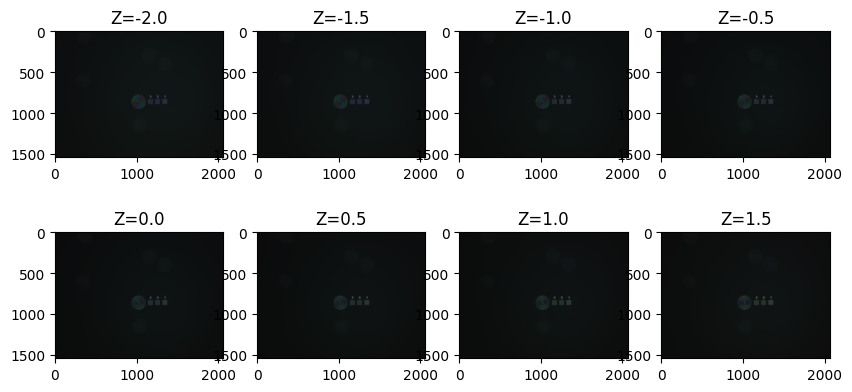

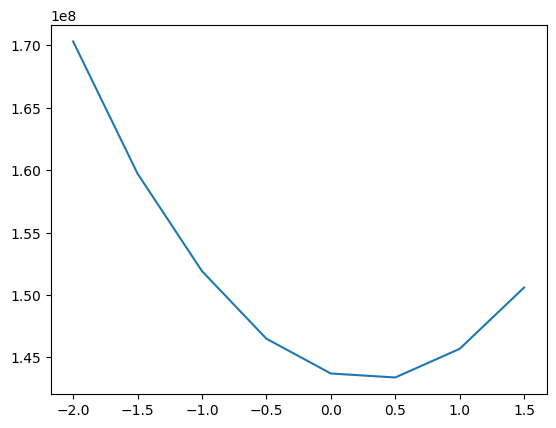

In [ ]:
arr = []
range_set = [-2,2+.5,0.5]
figure(figsize=[10,10])
for ix,angle in enumerate(np.arange (*range_set)):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(4,4,ix+1)
    imshow(img)
    title(f"Z={angle}")
    print(angle, core.get_position("PIZStage"))
    arr.append(img)
    

figure()
arr= np.array(arr)
plot(np.arange (*range_set),arr.sum(axis=(1,2,3)))
tf.imwrite("_alginment_background.tif", arr)
    

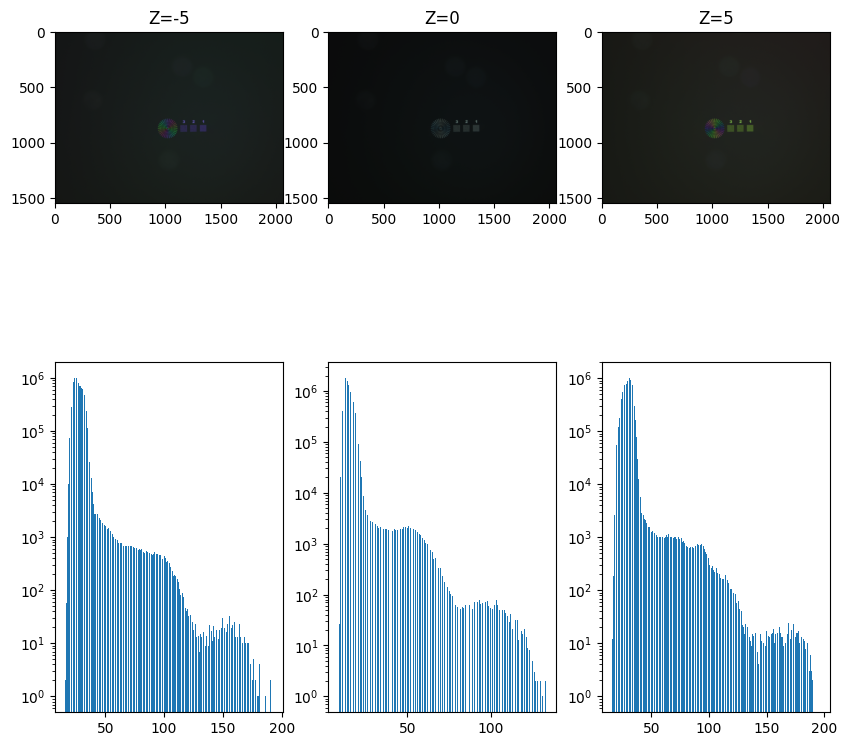

In [ ]:
#core.set_position("PIZStage",50277.0)

arr = []
range_set = [-5,0,5]
figure(figsize=[10,10])
for ix,angle in enumerate(range_set):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(2,3,ix+1)
    imshow(img)
    title(f"Z={angle}")
    subplot(2,3,(ix+4))
    hist(img.ravel(),bins=256)
    yscale('log')


In [28]:
1.5*1.4

2.0999999999999996

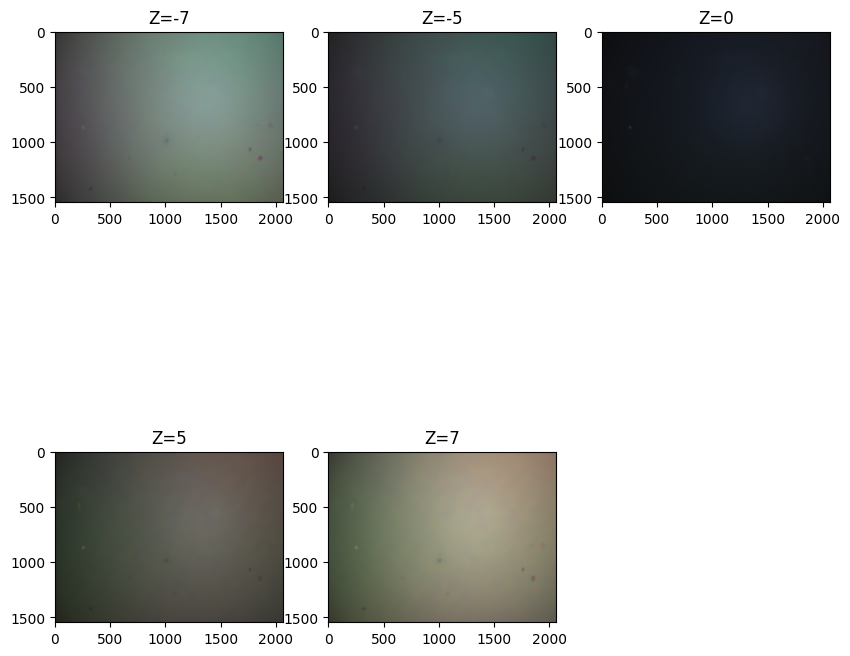

In [29]:
#core.set_position("PIZStage",50277.0)

bkarr = {}
range_set = [-7,-5,0,5,7]
figure(figsize=[10,10])
for ix,angle in enumerate(range_set):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(2,3,ix+1)
    imshow(img)
    title(f"Z={angle}")
#    subplot(2,3,(ix+4))
#    hist(img.ravel(),bins=256)
#    yscale('log')
    bkarr.update({angle:img})


In [30]:
for k in bkarr:
    print(k, bkarr[k].mean(), bkarr[k].max())

-7 109.40057505673374 175
-5 67.60880159590847 127
0 25.917213293770335 85
5 74.49088881608895 161
7 119.47656197701195 220


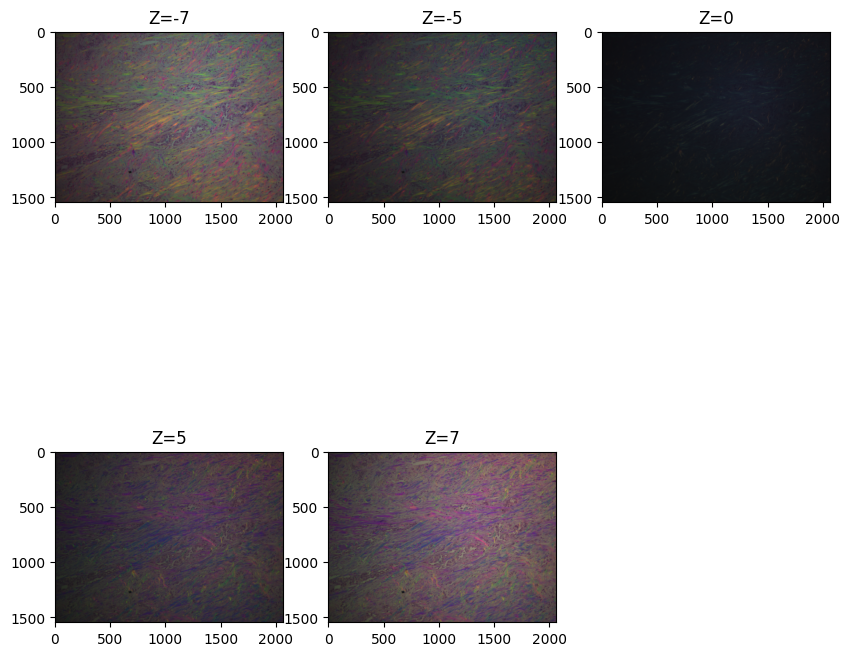

In [33]:
#core.set_position("PIZStage",50277.0)
# reduced exposure from 2ms to 1.8 (10%)
sample_arr = {}
range_set = [-7,-5,0,5,7]
figure(figsize=[10,10])
for ix,angle in enumerate(range_set):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(2,3,ix+1)
    imshow(img)
    title(f"Z={angle}")
#    subplot(2,3,(ix+4))
#    hist(img.ravel(),bins=256)
#    yscale('log')
    sample_arr.update({angle:img})


In [34]:
for k in bkarr:
    print(k, sample_arr[k].mean(), sample_arr[k].max())

-7 85.79207104102234 245
-5 54.65738132773694 170
0 22.460314725837115 77
5 55.84130053319677 163
7 87.79737267542274 237


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.14285714285714285..1.9758064516129032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.21311475409836064..2.426470588235294].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.29411764705882354..2.8095238095238093].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.16901408450704225..1.7045454545454546].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12612612612612611..1.4383561643835616].


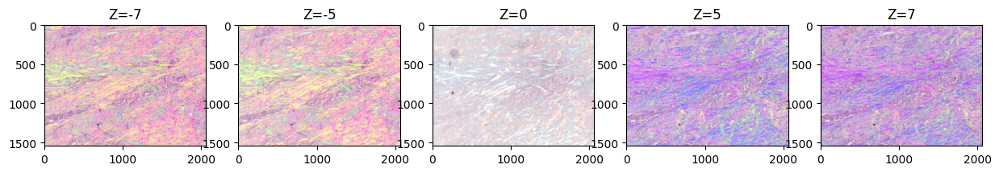

In [38]:
corr_arr = {}
figure(figsize=[15,5])
for ix,k in enumerate(bkarr):
    bkg = bkarr[k]
    data = sample_arr[k]
    data_corr = data *1.0 / bkg
    subplot(1,5,ix+1)
    imshow(data_corr)
    title(f"Z={k}")
    corr_arr.update({k:data_corr})

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.13964627855563744..1.1999458874458875].


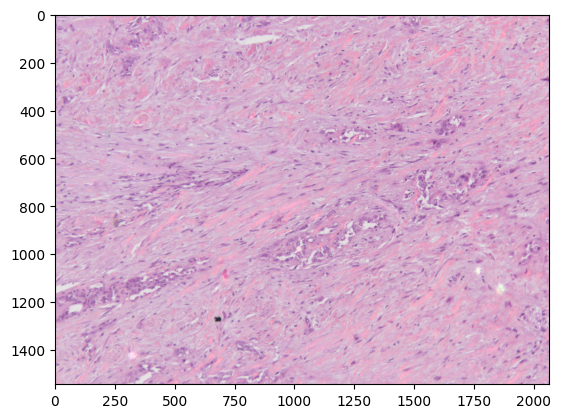

In [39]:

imshow((corr_arr[-7]+corr_arr[7])/2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.20514892634495496..1.4602048857368006].


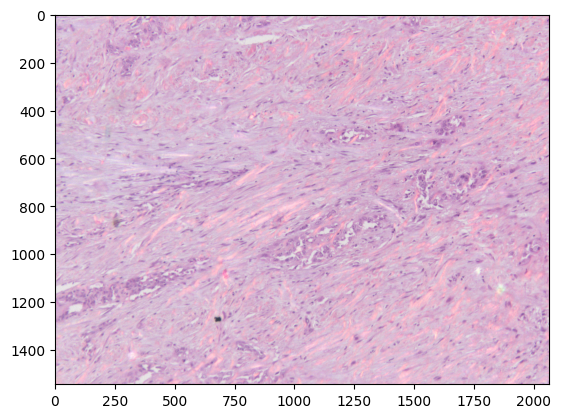

In [40]:

imshow((corr_arr[-5]+corr_arr[5])/2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0673076923076923..1.893939393939394].


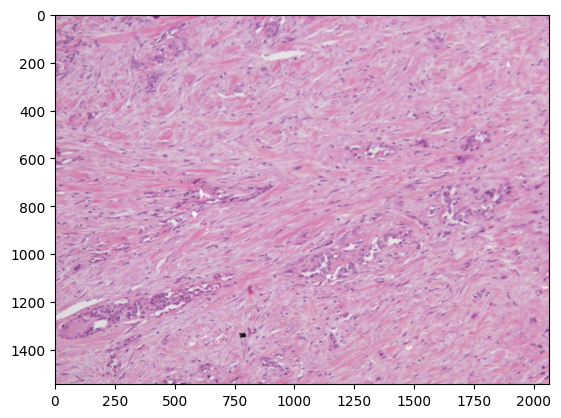

In [47]:
## corrected analyzer image
imshow(img_without_analyzer*0.5/bkg_without_analyzer)

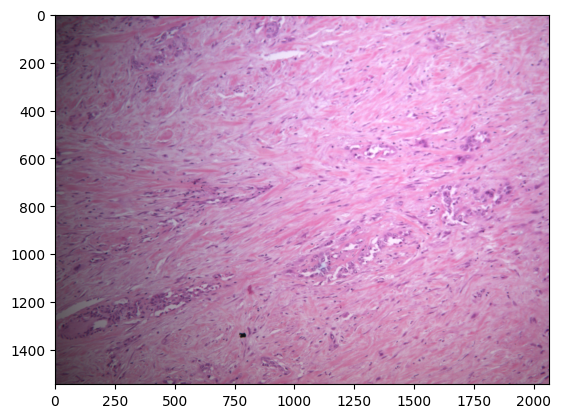

In [ ]:
#exposure at 0.05ms
img_without_analyzer, tags = microscope_hardware.snap_image()
imshow(img_without_analyzer)

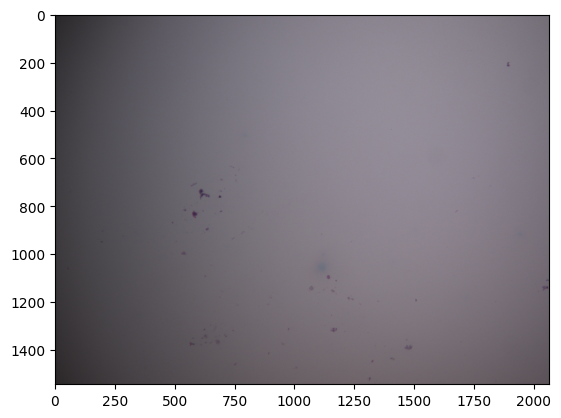

In [ ]:
#exposure at 0.02ms
bkg_without_analyzer, tags = microscope_hardware.snap_image()
imshow(bkg_without_analyzer)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5029958677685951..0.8180314309346568].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6155844155844157..1.0263666072489601].


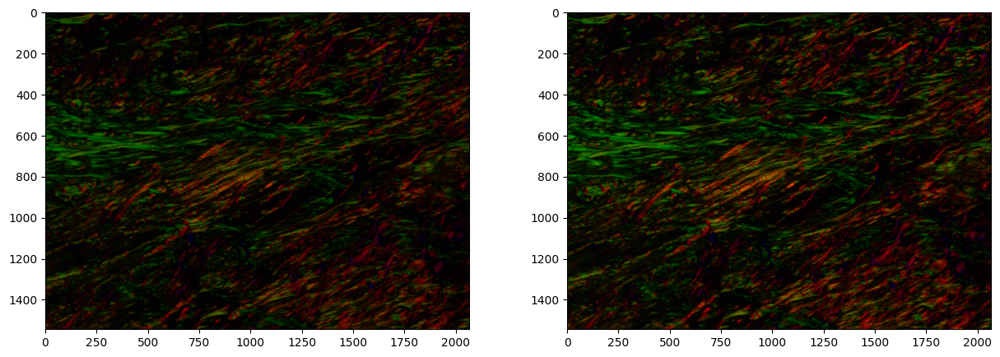

In [52]:
figure(figsize=[15,5])
subplot(121)
imshow((corr_arr[-7]-corr_arr[7])/2)
subplot(122)
imshow((corr_arr[-5]-corr_arr[5])/2)

In [53]:
biref_7 = (corr_arr[-7]-corr_arr[7])/2
biref_5 = (corr_arr[-5]-corr_arr[5])/2


In [54]:
biref_7_gray = biref_7.mean(axis=2)
biref_5_gray = biref_5.mean(axis=2)

In [89]:
biref_7_gray.mean(), biref_5_gray.max()

(np.float64(0.023718536598473335), np.float64(0.3776983987743144))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0673076923076923..1.893939393939394].


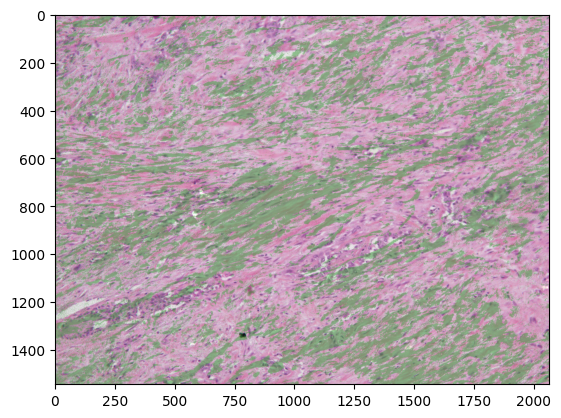

In [137]:
## corrected analyzer image

mask = biref_7_gray > biref_7_gray.mean()
overlay = np.zeros((*mask.shape, 4))
overlay[..., 0] = 0.2          # Blue channel
overlay[..., 1] = 0.6          # Blue channel
overlay[..., 2] = 0.2
overlay[..., 3] = mask * 0.5   # Alpha channel (transparency)

imshow(img_without_analyzer*0.5/bkg_without_analyzer,alpha=1.0)
imshow(overlay)


#imshow(biref_7_gray>biref_7_gray.mean(),cmap='Blues',alpha=0.3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0673076923076923..1.893939393939394].


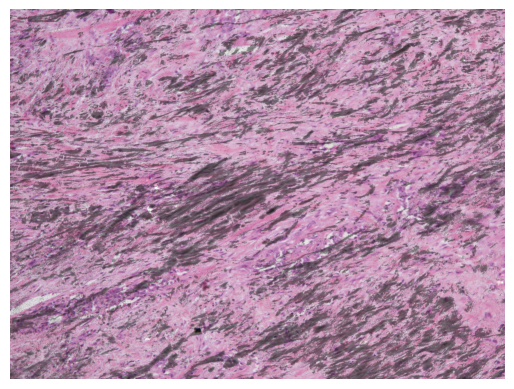

In [142]:

# Compute the overlay alpha (based on biref_7_gray, normalized 0–1)
alpha = (biref_7_gray - biref_7_gray.min()) / (np.ptp(biref_7_gray) + 1e-8)
mask = biref_7_gray > biref_7_gray.mean()
alpha[~mask]=0
# Create a blue overlay (R,G,B,A)
overlay = np.zeros((*biref_7_gray.shape, 4))
overlay[..., 0:3] = 0.1          # Blue channel
overlay[..., 3] = alpha        # Alpha from grayscale intensity

# Show the background image first
plt.imshow(img_without_analyzer * 0.5 / bkg_without_analyzer)

# Then overlay the tinted grayscale image
plt.imshow(overlay)

plt.axis('off')
plt.show()


(np.float64(-0.5), np.float64(2063.5), np.float64(1543.5), np.float64(-0.5))

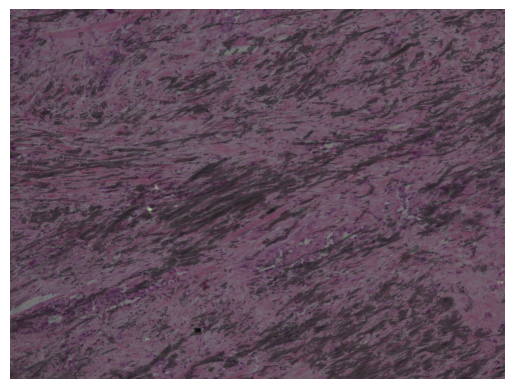

In [ ]:
# USING ONLY RGB TO MAKE COMPOSITE

alpha = (biref_7_gray - biref_7_gray.min()) / (np.ptp(biref_7_gray) + 1e-8)
mask = biref_7_gray > biref_7_gray.mean()
alpha[~mask] = 0

overlay = np.zeros((*biref_7_gray.shape, 4))
overlay[..., 0:3] = [0.1,0.1,0.1]          # black (RGB part)
overlay[..., 3] = alpha          # Alpha from grayscale intensity

base_img = img_without_analyzer * 0.5 / bkg_without_analyzer
base_img = np.clip(base_img / base_img.max(), 0, 1)

# ✅ Blend only RGB channels; use overlay alpha as transparency
black_overlay = (1 - overlay[..., 3][..., None]) * base_img + overlay[..., 3][..., None] * overlay[..., 0:3]

plt.imshow(black_overlay)
plt.axis('off')


(np.float64(-0.5), np.float64(2063.5), np.float64(1543.5), np.float64(-0.5))

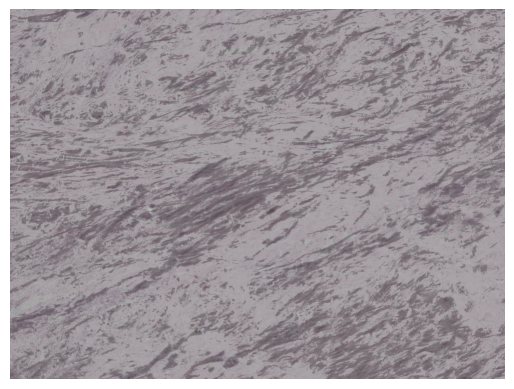

In [187]:
# USING ONLY RGBA TO MAKE COMPOSITE
alpha = (biref_7_gray - biref_7_gray.min()) / (np.ptp(biref_7_gray) + 1e-8)
mask = biref_7_gray > biref_7_gray.mean()
alpha[~mask] = 0

# ---- Overlay setup ----
overlay = np.zeros((*biref_7_gray.shape, 4))
overlay[..., 0:3] = .2 #[0.1, 0.1, 0.1]   #  overlay
overlay[..., 3] = alpha           # use grayscale as transparency

# ---- Base image (add alpha channel = 1) ----
base_img = img_without_analyzer * 0.5 / bkg_without_analyzer
base_img = np.clip(base_img / base_img.max(), 0, 1)
base_rgba = np.dstack([base_img, np.ones(base_img.shape[:2])*1.0])  # add full alpha

# ---- Blend both RGBA images ----
#black_overlay = (1 - overlay[..., 3][..., None]) * base_rgba + overlay[..., 3][..., None] * overlay

black_overlay =  overlay + base_rgba 
black_overlay = np.clip(black_overlay / black_overlay.max(), 0, 1)
# ---- Display result ----
plt.imshow(black_overlay)
plt.axis('off')


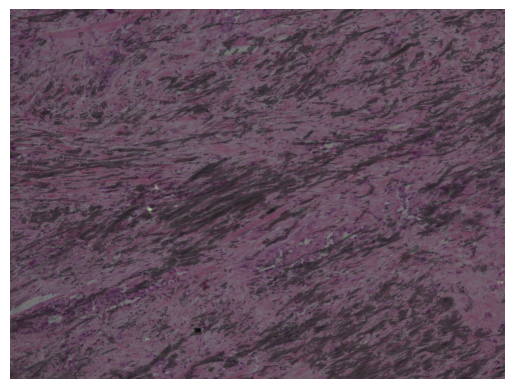

In [188]:
alpha = (biref_7_gray - biref_7_gray.min()) / (np.ptp(biref_7_gray) + 1e-8)
mask = biref_7_gray > biref_7_gray.mean()
alpha[~mask] = 0

# ---- create overlay (RGBA) ----
overlay = np.zeros((*biref_7_gray.shape, 4))
overlay[..., 0:3] = 0.1        # blue tint (you can use [0, 0, 1] for pure blue)
overlay[..., 3] = alpha        # alpha from grayscale

# ---- base image (make sure it's normalized RGB) ----
base = img_without_analyzer * 0.5 / bkg_without_analyzer
base = np.clip(base / base.max(), 0, 1)

# ---- flatten Matplotlib-style compositing ----
# (1 - alpha) * base + alpha * overlay_rgb
composite_rgb = (1 - overlay[..., 3][..., None]) * base + overlay[..., 3][..., None] * overlay[..., 0:3]

# ---- display equivalent composite ----
plt.imshow(composite_rgb)
plt.axis('off')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0673076923076923..1.893939393939394].


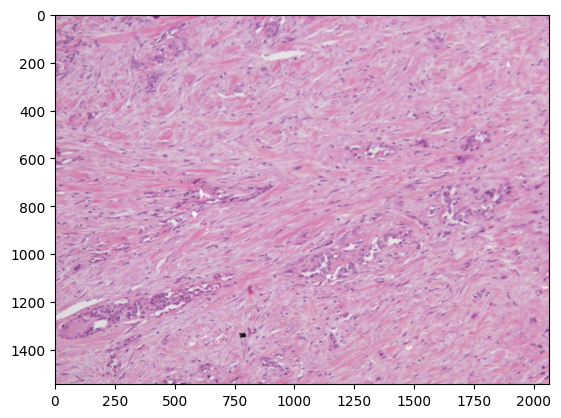

In [50]:
## corrected analyzer image
imshow(img_without_analyzer*0.5/bkg_without_analyzer)

In [ ]:
# moved to 20x lens

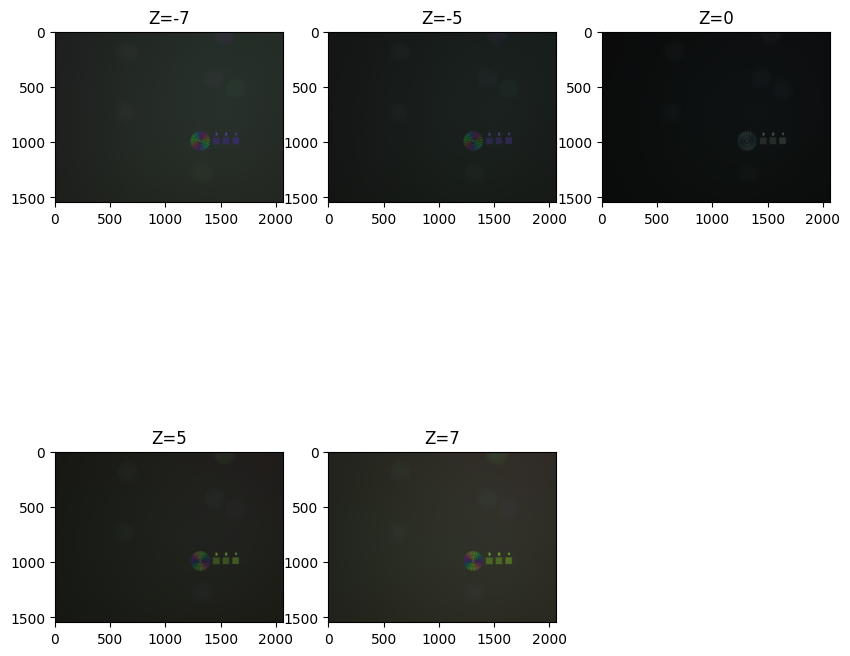

In [67]:
#core.set_position("PIZStage",50277.0)

gradient_slide = {}
range_set = [-7,-5,0,5,7]
figure(figsize=[10,10])
for ix,angle in enumerate(range_set):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(2,3,ix+1)
    imshow(img)
    title(f"Z={angle}")

    gradient_slide.update({angle:img})


In [68]:
for k in gradient_slide:
    print(k, gradient_slide[k].mean(), gradient_slide[k].max())

-7 38.4373256357861 192
-5 26.57542324376431 162
0 14.772455328453228 149
5 28.729288836673764 218
7 41.580906982601654 252


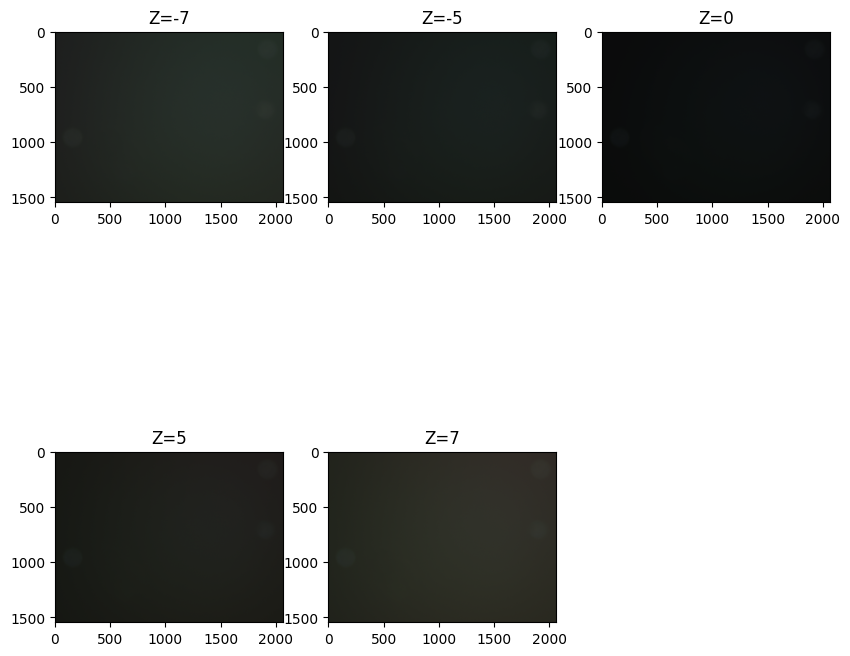

In [78]:

bkg_gradient_slide = {}
range_set = [-7,-5,0,5,7]
figure(figsize=[10,10])
for ix,angle in enumerate(range_set):
    anglex = angle*1000 + offset
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(2,3,ix+1)
    imshow(img)
    title(f"Z={angle}")

    bkg_gradient_slide.update({angle:img})

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.11428571428571428..1.192].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.09230769230769233..1.7125000000000001].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10857142857142858..1.4200000000000002].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08627450980392158..1.0595744680851065].


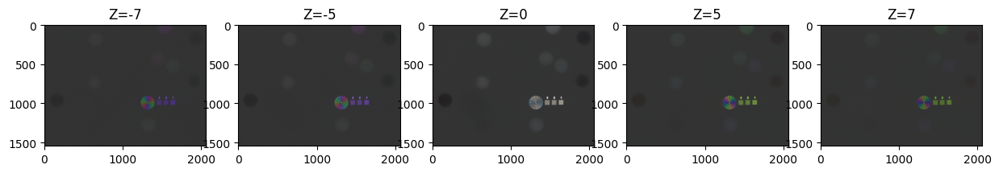

In [81]:
corr_gradient_arr = {}
figure(figsize=[15,5])
for ix,k in enumerate(bkarr):
    bkg = bkg_gradient_slide[k]
    data = gradient_slide[k]
    data_corr = data *0.2/ bkg
    subplot(1,5,ix+1)
    imshow(data_corr)
    title(f"Z={k}")
    corr_gradient_arr.update({k:data_corr})

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.35..0.3614285714285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.41588235294117654..0.3924285714285714].


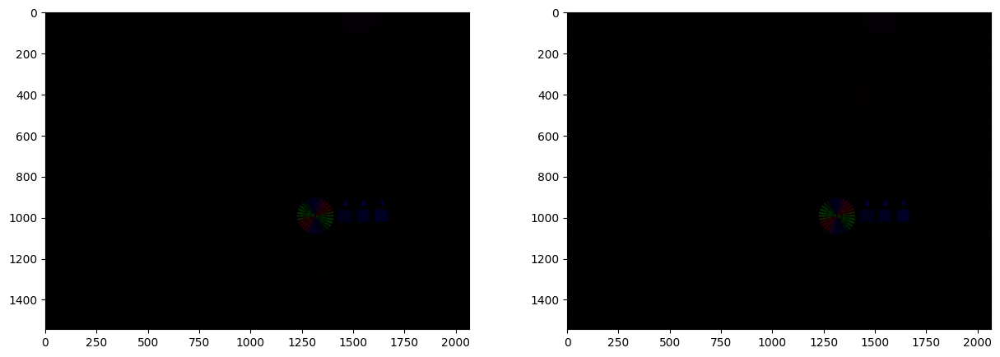

In [82]:
figure(figsize=[15,5])
subplot(121)
imshow((corr_gradient_arr[-7]-corr_gradient_arr[7])/2)
subplot(122)
imshow((corr_gradient_arr[-5]-corr_gradient_arr[5])/2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.35..0.3614285714285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.41588235294117654..0.3924285714285714].


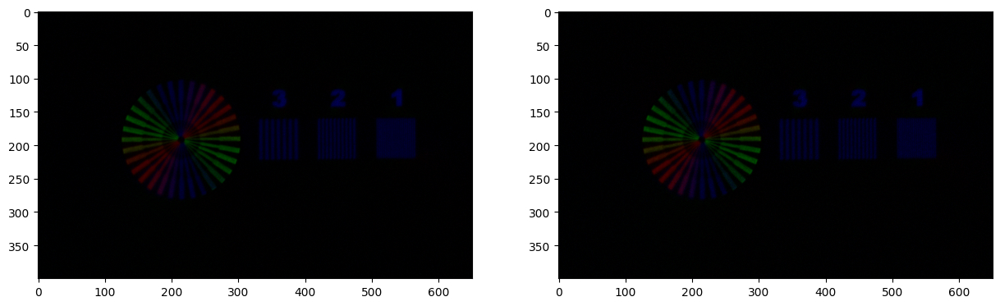

In [83]:
figure(figsize=[15,5])
subplot(121)
arx7 = (corr_gradient_arr[-7]-corr_gradient_arr[7])/2
imshow(arx7[800:1200,1100:1750])
subplot(122)
arx5 = (corr_gradient_arr[-5]-corr_gradient_arr[5])/2
imshow(arx5[800:1200,1100:1750])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5029958677685951..0.8180314309346568].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6155844155844157..1.0263666072489601].


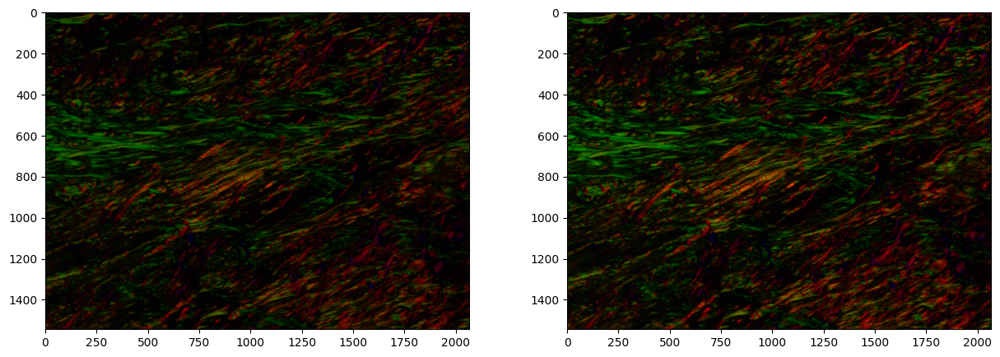

In [84]:
figure(figsize=[15,5])
subplot(121)
imshow((corr_arr[-7]-corr_arr[7])/2)
subplot(122)
imshow((corr_arr[-5]-corr_arr[5])/2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.659886910287788..0.7308363751785432].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6638655462184875..0.746597537265068].


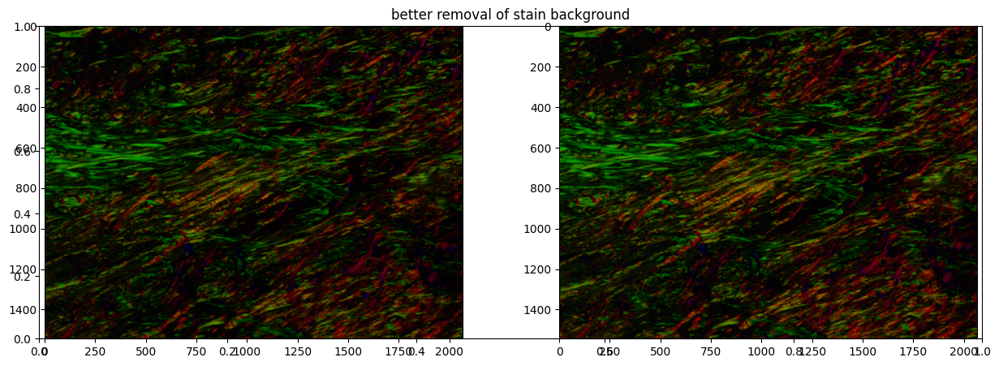

In [194]:


figure(figsize=[15,5])
title("better removal of stain background")
subplot(121)
imshow((corr_arr[-7]-corr_arr[7])*1.0/(corr_arr[-7]+corr_arr[7]))
subplot(122)
imshow((corr_arr[-5]-corr_arr[5])*1.0/(corr_arr[-5]+corr_arr[5]))

# save data for yuming



In [222]:
import os
os.chdir(r'D:\User\locisuer\Desktop\Yuming_data_with_shribak')
for k in bkarr.keys():
    
    #tf.imwrite(f"A_background_10x_deg{k}.tif", bkarr[k])
    #tf.imwrite(f"B_sample_array_10x_deg{k}.tif",sample_arr[k])
    tf.imwrite(f"C_corrected_array_10x_deg{k}.tif",make_cxfloat_cxuint8(corr_arr[k],0))
    #tf.imwrite(f"D_gradient_slide_20x_deg{k}.tif",gradient_slide[k])
    #tf.imwrite(f"E_bkg_gradient_slide_20x_deg{k}.tif",bkg_gradient_slide[k])
    tf.imwrite(f"F_corrected_gradient_slide_20x_deg{k}.tif",make_cxfloat_cxuint8(corr_gradient_arr[k],0))


In [220]:
def make_cxfloat_cxuint8(cx,contrast_stretch = 0.05):    
    if cx.dtype==np.float64:
        from skimage.util import img_as_ubyte

        #min_val = cx.min()
        #max_val = cx.max()
        
        min_val = np.percentile(cx, 0+contrast_stretch)
        max_val = np.percentile(cx, 100-contrast_stretch)
        normalized_float = np.clip((cx - min_val) / (max_val - min_val), 0.0, 1.0)
        uint8_rgb_array = img_as_ubyte(normalized_float)
        
        return(uint8_rgb_array)
    else:
        raise("input is not float64")
        return (cx)

In [221]:

tf.imwrite("C2_image_without_analyzer.tif",img_without_analyzer)
tf.imwrite("C2_bkg_without_analyzer.tif",bkg_without_analyzer)
tf.imwrite("C2_composite_image.tif",make_cxfloat_cxuint8(composite_rgb,0))


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12612612612612611..1.4383561643835616].


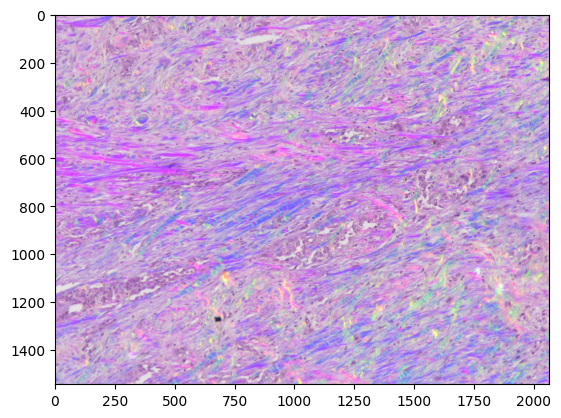

In [206]:
imshow(corr_arr[k])

float64 (1544, 2064, 3) 0.12612612612612611 1.4383561643835616
uint8 (1544, 2064, 3) 14 237


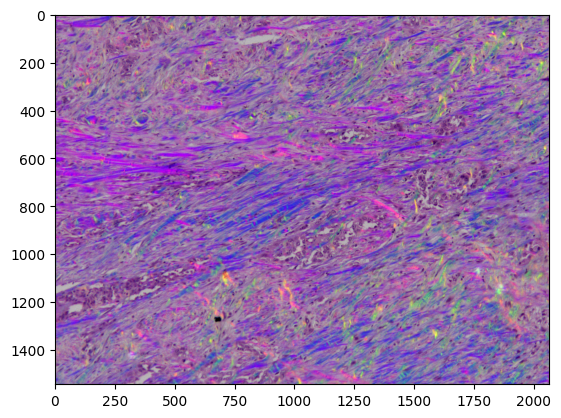

In [212]:
for cx in [corr_arr[k],sample_arr[k]]:
    print(cx.dtype, cx.shape, cx.min(),cx.max())
    if cx.dtype==np.float64:
        from skimage.util import img_as_ubyte

        #min_val = cx.min()
        #max_val = cx.max()
        contrast_stretch = 0.05
        min_val = np.percentile(cx, 0+contrast_stretch)
        max_val = np.percentile(cx, 100-contrast_stretch)
        normalized_float = np.clip((cx - min_val) / (max_val - min_val), 0.0, 1.0)
        uint8_rgb_array = img_as_ubyte(normalized_float)
        
        imshow(uint8_rgb_array)

In [216]:
cx.dtype

dtype('uint8')

In [195]:
arr = []
for ix,angle in enumerate(range (-7,6,1)):
    anglex = angle*1000 + 50277
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(4,4,ix+1)
    imshow(img)
    title(f"Z={angle}")
    print(angle, core.get_position("PIZStage"))
    arr.append(img)
    

figure()
arr= np.array(arr)
plot(range (-7,6,1),arr.sum(axis=(1,2,3)))
tf.imwrite("background.tif", arr)
    

KeyboardInterrupt: 

-7 43274.5
-6 44275.5
-5 45275.5
-4 46275
-3 47275.5
-2 48275
-1 49275.5
0 50275.5
1 51276
2 52275.5
3 53275.5
4 54275.5
5 55275


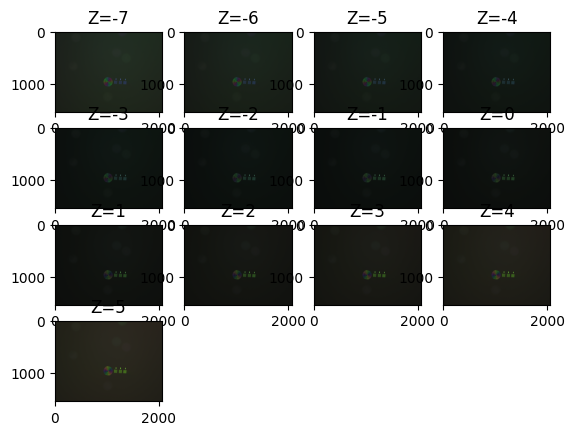

In [44]:
arr = []
for ix,angle in enumerate(range (-7,6,1)):
    anglex = angle*1000 + 50277
    core.set_position("PIZStage",anglex)
    core.wait_for_device("PIZStage")
    img,tags = microscope_hardware.snap_image()
    subplot(4,4,ix+1)
    imshow(img)
    title(f"Z={angle}")
    print(angle, core.get_position("PIZStage"))
    arr.append(img)
    

In [27]:
import tifffile as tf

In [45]:
tf.imwrite("for_yuming_calibration.tif", arr)

In [28]:
import os
os.getcwd()

'c:\\Users\\lociuser\\Codes\\smartpath\\smart-wsi-scanner\\src\\dev'

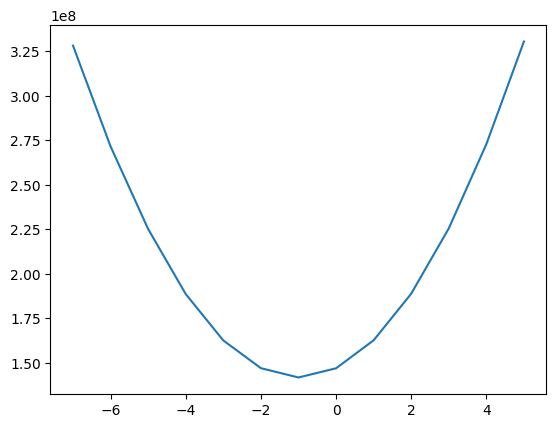

In [46]:
arr= np.array(arr)
arr.shape
plot(range (-7,6,1),arr.sum(axis=(1,2,3)))

In [197]:
arr= np.array(arr)
arr.shape
plot(range (-7,6,1),arr.sum(axis=(1,2,3)))

AxisError: axis 1 is out of bounds for array of dimension 1

In [193]:
plot(range (-5,6,1),arr.sum(axis=(1,2,3)))

AttributeError: 'list' object has no attribute 'sum'

In [5]:
ppm_settings['stage']['limits']['z_um']

{'low': -2200, 'high': -1600}

In [5]:
microscope_hardware.get_current_position()

Position(x=14838, y=2008, z=-2077.3)

In [6]:
imshow(np.mean(img,2))
colorbar()

NameError: name 'img' is not defined

[-2099.8  -2088.55 -2077.3  -2066.05 -2054.8 ]


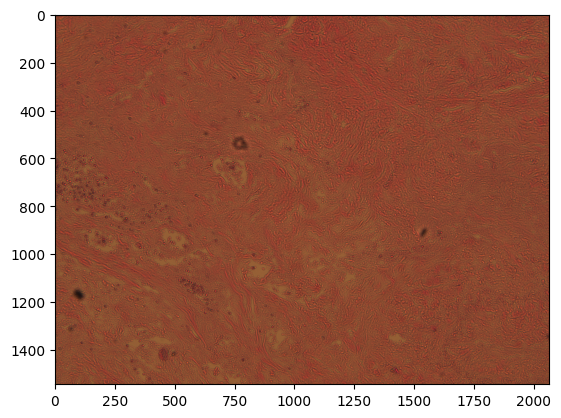

<Figure size 640x480 with 0 Axes>

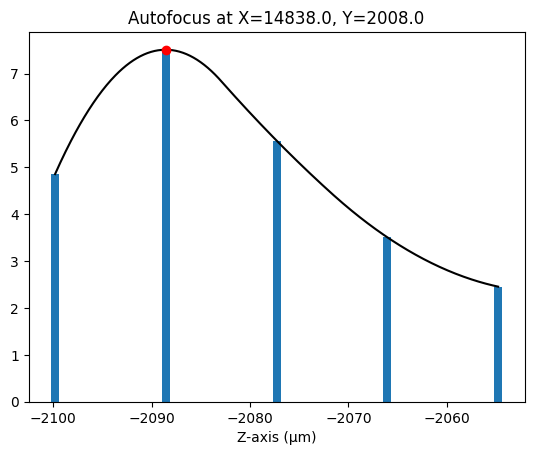

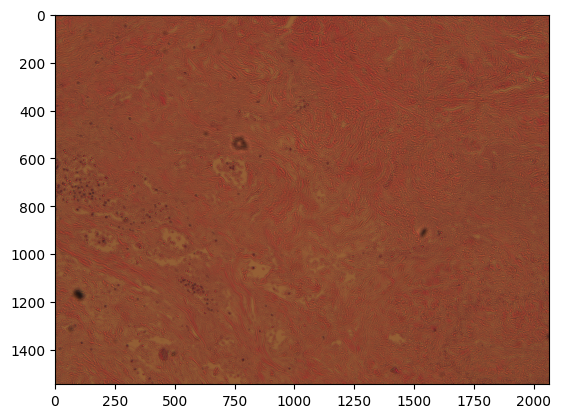

In [7]:
img, tags = microscope_hardware.snap_image()
imshow(img)
figure()
microscope_hardware.autofocus( 
        n_steps=5,
        search_range=45,
        #interp_strength=100,
        #interp_kind="quadratic",
        #score_metric=skimage.filters.sobel,
        pop_a_plot=True,
        #move_stage_to_estimate=True,
    )
img, tags = microscope_hardware.snap_image()
figure()
imshow(img)

In [8]:
2088.5

Position(x=14838, y=2008, z=-2078.5)

np.float64(-2098.5)

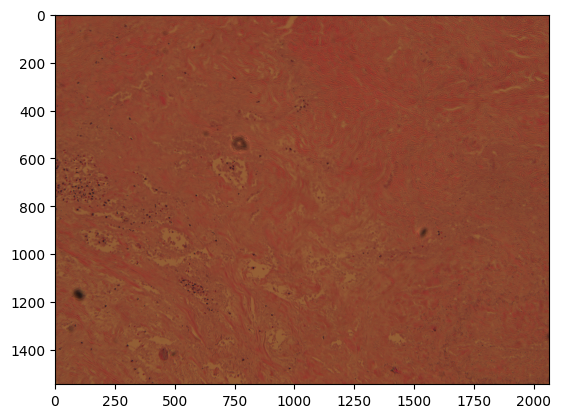

In [9]:
img, tags = microscope_hardware.snap_image()
imshow(img)
z = microscope_hardware.autofocus_adaptive_search( 
        initial_step_size=10,
        min_step_size=2,
        focus_threshold=0.95,
        max_total_steps=25,
        score_metric=None,
        pop_a_plot=False,
        move_stage_to_estimate=True,
    )
img, tags = microscope_hardware.snap_image()
imshow(img)
z

In [17]:
microscope_hardware.core.set_exposure(2.0)

(<matplotlib.image.AxesImage at 0x1e75f4fb1d0>,
 array([ 98.70786484, 112.93319539,  93.46325078]))

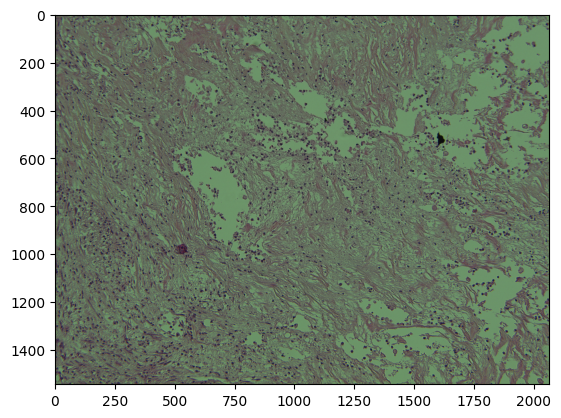

In [19]:
img, tags = microscope_hardware.snap_image()
imshow(img), img.mean((0,1))

In [ ]:
for k in range(20):
    microscope_hardware.set_psg_ticks(-5.0)
    microscope_hardware.core.set_exposure()
    img, tags = microscope_hardware.snap_image()
    microscope_hardware.set_psg_ticks(90)
    img, tags = microscope_hardware.snap_image()
    microscope_hardware.core.set_property("JAICamera","Exposure",0.5)
    microscope_hardware.core.set_property("JAICamera","FrameRateHz",1)



In [5]:
import os
os.getcwd()

'c:\\Users\\lociuser\\Codes\\smartpath\\smart-wsi-scanner\\src\\dev'

In [4]:
ppm_config = ppm_settings.get('modalities', {}).get('ppm', {})
rotation_device = ppm_config.get('rotation_stage', {}).get('device')
#ppm_settings.get('rotation_stage', {}).get('device')
device_name = ppm_settings.get('id_stage', {}).get(rotation_device, {}).get('device')
device_name

'KBD101_Thor_Rotation'

dict_keys(['microscope', 'modalities', 'acq_profiles_new', 'stage', 'slide_size_um', 'id_stage', 'id_detector', 'id_objective_lens'])

In [44]:
future_ = config.load_config(r'C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\dev\yaml_test\michaels_future_yaml.yml')
future_ = config.load_config(r'C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\smart_wsi_scanner\configurations\config_PPM_future.yml')
future_.autofocus.x10.id

In [29]:
future_.backgrounds.base_folder

'D:/2025QPSC/data/background_tiles'

In [33]:
#future_.camera_templates.LOCI_CAMERA_002_base.sensor.height
#future_.exposure_sequence
#future_.modalities.ppm_10x.cameras.LOCI_CAMERA_002.sensor
future_.autofocus

[{'lens10x': None, 'n_steps': 9, 'search_range': 50, 'n_tiles': 5},
 {'lens20x': None, 'n_steps': 11, 'search_range': 25, 'n_tiles': 5},
 {'lens40x': None, 'n_steps': 15, 'search_range': 10, 'n_tiles': 7}]

In [8]:
microscope_hardware.get_fov()

(1417.1424, 1060.1104)

In [28]:
core.get_property("Core", "Camera")

'JAICamera'

True

NameError: name 'microscope_hardware' is not defined

In [9]:
core.get_property("Core",'Camera')

'JAICamera'

In [10]:
import os
root = os.getcwd()
print(root)
try : 
    os.chdir(r'..\smart_wsi_scanner')
    from smart_wsi_scanner.qp_utils import BackgroundCorrectionUtils
except Exception as e: 
    print(e)
finally:
    os.chdir(root)


c:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\dev


In [14]:
ppm_settings.keys()

dict_keys(['microscope', 'modalities', 'acq_profiles_new', 'stage', 'slide_size_um'])

In [12]:
background_image = ppm_settings['background_correction']
background_image

KeyError: 'background_correction'

In [22]:
import logging
filename = 'test_2_del.log'
logging.basicConfig(
)
logger = logging.getLogger(__name__)


In [8]:
from pathlib import Path
list(Path(background_image.background_folder).glob('*.*'))

[]

In [9]:
background_image.background_folder

'D:/2025QPSC/data/background_tiles'

In [19]:
ppm_settings['modalities']['ppm']['background_correction']['base_folder']

'D:/2025QPSC/data/background_tiles'

In [24]:
from pathlib import Path
#background_images, background_scaling_factors 
backgrounds, scaling_factors, white_balance_coeffs= BackgroundCorrectionUtils.load_background_images(
                            Path(ppm_settings['modalities']['ppm']['background_correction']['base_folder']),
                            'ppm_10x',
                            [-5.0,5.0],
                            logger
                        )

In [11]:
from matplotlib.pyplot import *

In [25]:
imshow(background_images[-5])

NameError: name 'background_images' is not defined

In [26]:
image,tags = microscope_hardware.snap_image(debayering=False)

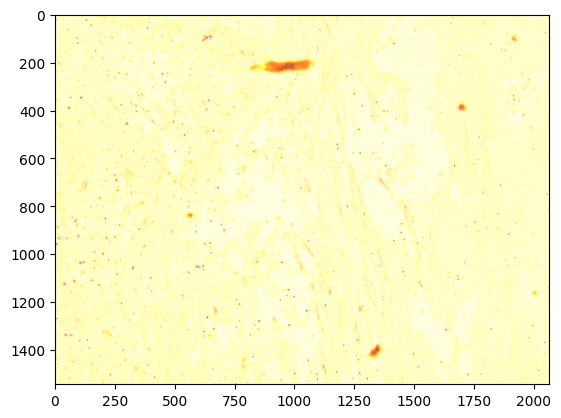

In [27]:
imshow(image)

In [28]:
microscope_hardware.core.set_property("JAICamera", "WhiteBalance", "Continuous")

In [29]:
microscope_hardware.core.get_exposure()


25.845

In [ ]:
from collections import OrderedDict
microscope_hardware.core.snap_image()  # type: ignore
tagged_image = microscope_hardware.core.get_tagged_image()  # type: ignore
## TODO : check if ordering helps in presentation?
tags = OrderedDict(sorted(tagged_image.tags.items()))
## tags = tagged_image.tags
pixels = tagged_image.pix
total_pixels = pixels.shape[0]
height, width = tags["Height"], tags["Width"]
assert (total_pixels % (height * width)) == 0
nchannels = total_pixels // (height * width)
nchannels, height, width

(4, 1544, 2064)

In [17]:
if nchannels > 1:
    pixels = pixels.reshape(height, width, nchannels)
else:
    pixels = pixels.reshape(height, width)
pixels.shape

(1544, 2064, 4)

In [18]:
pixels = pixels[:, :, ::-1]

In [19]:
pixels = pixels[:, :, 1:]  # ARGB the alpha-channel is all zeros by default?


In [30]:
imshow(pixels)

NameError: name 'pixels' is not defined

In [17]:
angle = -5.0
bc_method = ppm_settings.background_correction.method
imagex = BackgroundCorrectionUtils.apply_flat_field_correction(
    image, 
    background_images[angle],
    background_scaling_factors[angle],
    method=bc_method
)



In [18]:
background_scaling_factors

{-5.0: np.float32(0.88105726), 5.0: np.float32(0.93457943)}

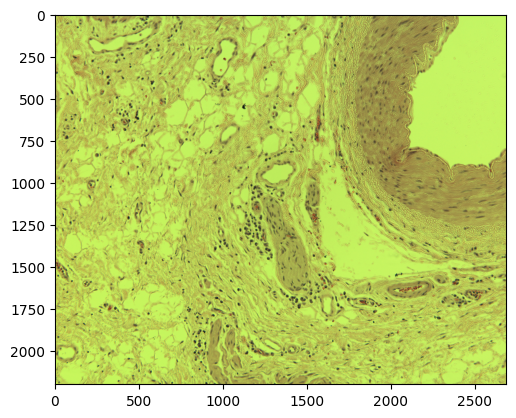

In [20]:
imshow(imagex)

In [53]:
image.dtype

dtype('uint8')

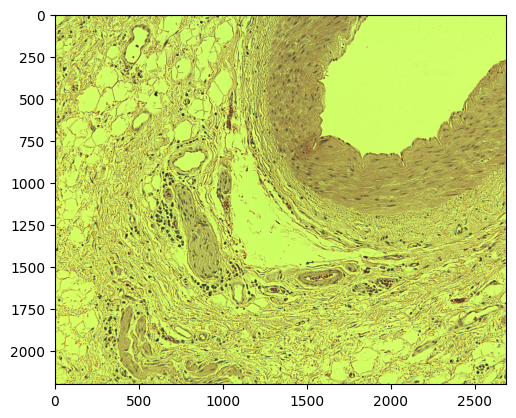

In [52]:
# Ensure float precision for calculations
img_float = image.astype(np.float32)
bg_float  = background_images[-5].astype(np.float32)
epsilon = 0.1
bg_float = np.where(bg_float < epsilon, epsilon, bg_float)
corrected = (img_float / bg_float) * background_scaling_factors[-5]
imshow(corrected)

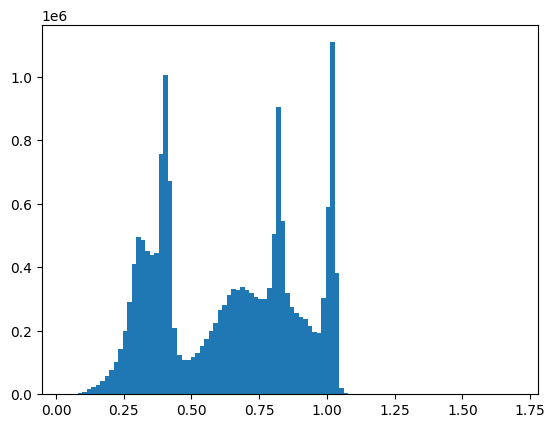

In [55]:
hist(corrected.ravel(),100);

In [ ]:
overflow_mask = corrected > 240

In [ ]:
def apply_flat_field_correction2(
        image: np.ndarray,
        background: np.ndarray,
        scaling_factor: float,
        method: str = "divide",
    ) -> np.ndarray:
        """
        Apply flat-field correction with pre-calculated scaling for consistency.
        
        The scaling_factor is calculated once per background image and applied
        to all tiles to ensure seamless stitching.
        """
        # Ensure float precision for calculations
        img_float = image.astype(np.float32)
        bg_float  = background.astype(np.float32)
        
        # Prevent division by zero with small epsilon
        epsilon = 0.1
        bg_float = np.where(bg_float < epsilon, epsilon, bg_float)
        
        if method == "divide":
            # Apply the correction with consistent scaling
            corrected = (img_float / bg_float) * scaling_factor
            
            # For 8-bit images, we need to handle the range carefully
            # The scaling_factor is chosen to keep most values in range,
            # but we still need to handle outliers
            
            if image.dtype == np.uint8:
                # Soft clipping approach: compress the high values rather than hard clip
                # This preserves some detail in very bright areas
                
                # Find where we're exceeding the range
                overflow_mask = corrected > 240  # Leave some headroom
                
                if np.any(overflow_mask):
                    # Compress the overflow region
                    overflow_values = corrected[overflow_mask]
                    # Map [240, max] -> [240, 254] with log compression
                    max_val = overflow_values.max()
                    if max_val > 240:
                        compressed = 240 + (254 - 240) * np.log1p(overflow_values - 240) / np.log1p(max_val - 240)
                        corrected[overflow_mask] = compressed
            
        elif method == "subtract":
            # For subtraction, we need a different approach
            # Scale the background to match the image intensity range
            bg_scaled = bg_float * scaling_factor
            corrected = img_float - (bg_float - bg_scaled)
            corrected = np.maximum(corrected, 0)  # No negative values
        
        # Final clipping to valid range
        if image.dtype == np.uint8:
            max_val = 255
        elif image.dtype == np.uint16:
            max_val = 65535
        else:
            max_val = 255  # Default for unknown types
        
        return np.clip(corrected, 0, max_val).astype(image.dtype)

In [46]:
imagex.dtype

dtype('uint8')

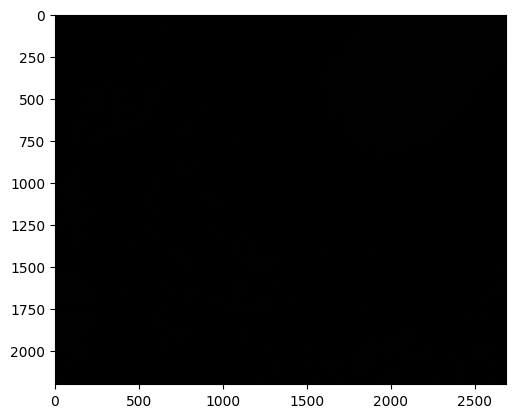

In [43]:
imshow(imagex)

In [ ]:
#gain = 1.0
#else:
#gain = calculate_luminance_gain(*angles_wb[angle])
# white balance

In [18]:
## testing autofocus on sobel and bf
from sws.qp_utils import TileConfigUtils, TifWriterUtils, AutofocusUtils
tileconfig = r"D:\User\locisuer\Desktop\TileConfiguration.txt"
positions = TileConfigUtils.read_tile_config(tileconfig, microscope_hardware.core) 


ModuleNotFoundError: No module named 'sws'

In [16]:
microscope_hardware.autofocus(pop_a_plot=True)

np.float64(-130.8671342685371)

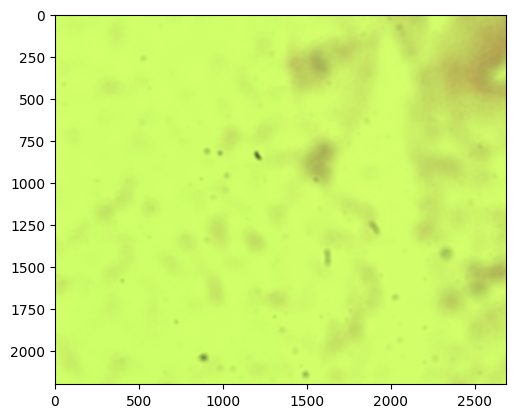

In [17]:
img,tags= microscope_hardware.snap_image()
plt.imshow(img)

In [21]:
os.chdir(r"C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\dev")
os.getcwd()

'C:\\Users\\lociuser\\Codes\\smartpath\\smart-wsi-scanner\\src\\dev'

In [22]:
import os
root = os.getcwd()
print(root)
try : 
    os.chdir(r'..\smart_wsi_scanner\debayering\src')
    from main_cpu import CPUDebayer
except Exception as e: 
    print(e)
finally:
    os.chdir(root)


C:\Users\lociuser\Codes\smartpath\smart-wsi-scanner\src\dev


In [39]:
#plt.imshow(pixels)

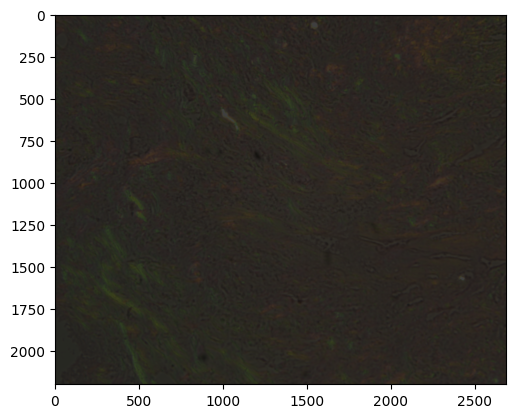

In [48]:
pixels = imgbw[0].copy()
debayerx = CPUDebayer(
                pattern="GRBG",
                image_bit_clipmax=(2**16) - 1,
                image_dtype=np.uint16,
                convolution_mode="wrap",
            )
pixels = debayerx.debayer(pixels)
image_normalized = pixels / 65535.0
plt.imshow(image_normalized)

In [54]:
(2**14)-1

16383

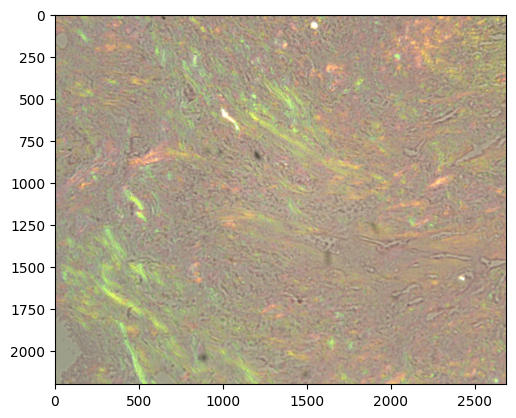

In [49]:
pixels = ((pixels / (2**14) + 1) * 255).astype(np.uint8)
plt.imshow(pixels)

In [6]:
#microscope_hardware.get_device_properties()

In [ ]:
## rotational stage control
microscope_hardware.set_psg_ticks(90)
microscope_hardware.get_psg_ticks()

89.99225

In [4]:
# translational stage control
sp = sws.sp()
microscope_hardware.move_to_position(sp.position(x=7960,y=4821,z=-71))
microscope_hardware.get_current_position()

sp_position(x=7960.0, y=4821.0, z=-71.0)

In [ ]:
## white balancing

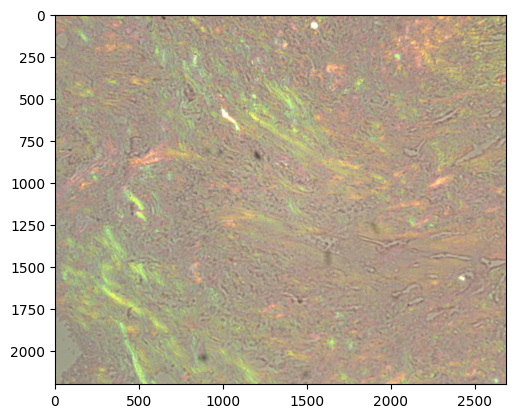

In [7]:
img1, tags = microscope_hardware.snap_image(debayering=False)
plt.imshow(img1)  # if RGBA or ARGB, only show RGB

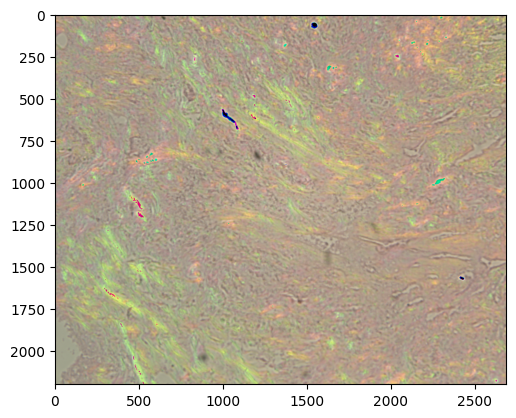

In [8]:
img2, tags = microscope_hardware.snap_image(debayering=True)
plt.imshow(img2)  # if RGBA or ARGB, only show RGB

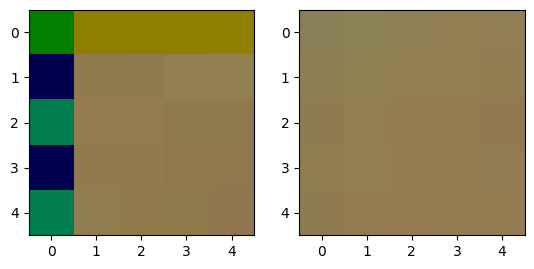

In [7]:
plt.subplot(121)
plt.imshow(img1[:5,:5,:]) 
plt.subplot(122)
plt.imshow(img2[:5,:5,:]) 

IndexError: too many indices for array: array is 2-dimensional, but 3 were indexed

In [31]:
for angle_,exp_ in zip([-5.0, 0.0, 5.0, 90.0], [1000, 2000, 1000, 15]):
    microscope_hardware.set_psg_ticks(angle_)
    microscope_hardware.core.set_exposure(exp_)
    img, tags = microscope_hardware.snap_image()
    rgb = img.mean((0,1))
    print(angle_, exp_,rgb/rgb.min())
    

-5.0 1000 [1.81489925 1.70723008 1.        ]
0.0 2000 [1.33363137 1.17596971 1.        ]
5.0 1000 [1.38673833 1.6424885  1.        ]
90.0 15 [1.97220307 2.38955037 1.        ]


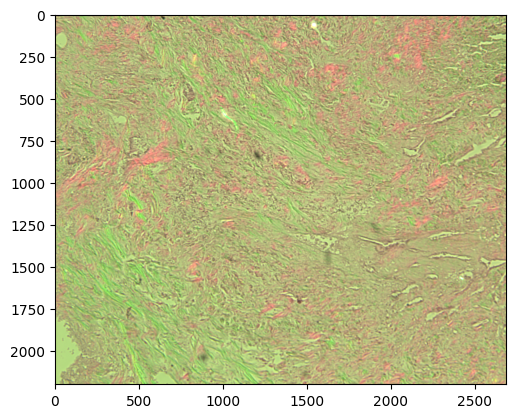

In [29]:
img, tags = microscope_hardware.snap_image()
plt.imshow(img)

In [24]:
ppm_settings.white_balance.ppm.crossed

[1.0, 1.1338, 1.2957]

In [25]:
rgb = img.mean((0,1))
rgb/rgb.min()

array([1.30689807, 1.19235709, 1.        ])

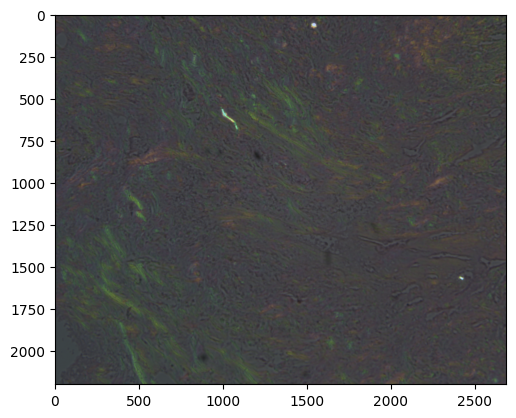

In [27]:
imgx = microscope_hardware.white_balance(img, white_balance_profile= (1.30689807, 1.19235709, 1.   ))
plt.imshow(imgx)

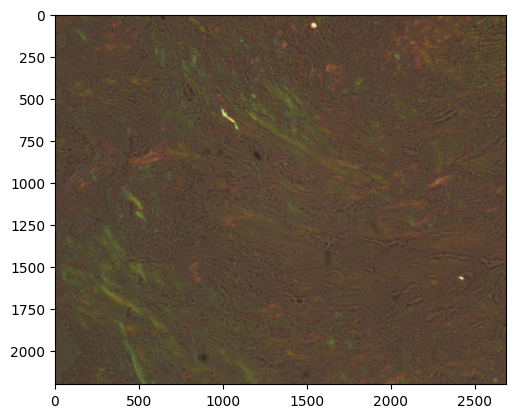

In [26]:
imgx = microscope_hardware.white_balance(img, white_balance_profile= ppm_settings.white_balance.ppm.crossed)
plt.imshow(imgx)

In [6]:
#microscope_hardware.autofocus(pop_a_plot=True)

In [ ]:
img, tags = microscope_hardware.snap()

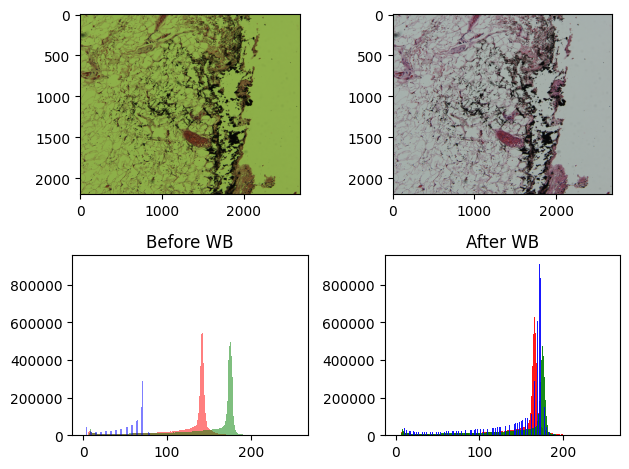

In [ ]:
# self - white balancing

plt.subplot(221)
plt.imshow(img)
plt.subplot(222)
img_wb = microscope_hardware.white_balance(img, background_image= img, gain=1.0,
                       #white_balance_profile=ppm_settings.white_balance.ppm.uncrossed
                       )
plt.imshow(img_wb)
ax1 = plt.subplot(223)
ax2 = plt.subplot(224)
plt.sca(ax1)
plt.title('Before WB')
plt.sca(ax2)
plt.title('After WB')
for ix,channel in enumerate(['Red','Green','Blue']):
    ax1.hist(img[:,:,ix].ravel(),bins=256,alpha=0.5,label=channel,color=channel.lower())
    ax2.hist(img_wb[:,:,ix].ravel(),bins=256,alpha=0.9,label=channel,color=channel.lower())
plt.tight_layout()

In [ ]:
## making a background and white balancing with it

In [9]:
bkg = img.copy()

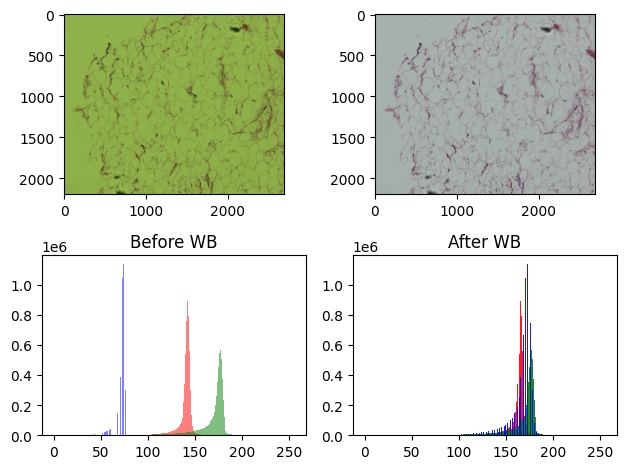

In [11]:
img, tags = microscope_hardware.snap()       

plt.subplot(221)
plt.imshow(img)
plt.subplot(222)
img_wb = microscope_hardware.white_balance(img, background_image= bkg, gain=1.0)
plt.imshow(img_wb)
ax1 = plt.subplot(223)
ax2 = plt.subplot(224)
plt.sca(ax1)
plt.title('Before WB')
plt.sca(ax2)
plt.title('After WB')
for ix,channel in enumerate(['Red','Green','Blue']):
    ax1.hist(img[:,:,ix].ravel(),bins=256,alpha=0.5,label=channel,color=channel.lower())
    ax2.hist(img_wb[:,:,ix].ravel(),bins=256,alpha=0.9,label=channel,color=channel.lower())
plt.tight_layout()

In [ ]:
# List of RGB combinations
color_map = {
    (0, 0, 0): "Black",
    (1, 0, 0): "Red",
    (0, 1, 0): "Green",
    (0, 0, 1): "Blue",
    (1, 1, 0): "Yellow",
    (1, 0, 1): "Magenta",
    (0, 1, 1): "Cyan",
    (1, 1, 1): "White"
}
for rgb in color_map:
    red, green, blue = rgb
    core.set_property('MicroPublisher6', 'Color - Red scale', float(red))
    core.set_property('MicroPublisher6', 'Color - Green scale', float(green))
    core.set_property('MicroPublisher6', 'Color - Blue scale', float(blue))

    img, tags = microscope_hardware.snap(remove_alpha=False)

    mean_color = img.mean(axis=(0, 1))  # Assuming shape is (height, width, channels)
    color_name = color_map[rgb]
    print(f"Color {rgb} ({color_name}): Mean = {mean_color}")
    

##OUTPUT shows its ARGB
   
# Color (0, 0, 0) (Black): Mean = [0. 0. 0. 0.]
# Color (1, 0, 0) (Red): Mean = [  0.         108.34808442   0.           0.        ]
# Color (0, 1, 0) (Green): Mean = [  0.           0.         108.47680465   0.        ]
# Color (0, 0, 1) (Blue): Mean = [  0.           0.           0.         108.30334416]
# Color (1, 1, 0) (Yellow): Mean = [  0.         108.38217532 108.43857413   0.        ]
# Color (1, 0, 1) (Magenta): Mean = [  0.         108.38246753   0.         108.3367316 ]
# Color (0, 1, 1) (Cyan): Mean = [  0.           0.         108.44347944 108.33607143]
# Color (1, 1, 1) (White): Mean = [  0.         108.39569264 108.45292749 108.34406926]

Color (0, 0, 0) (Black): Mean = [0. 0. 0. 0.]
Color (1, 0, 0) (Red): Mean = [  0.         108.34808442   0.           0.        ]
Color (0, 1, 0) (Green): Mean = [  0.           0.         108.47680465   0.        ]
Color (0, 0, 1) (Blue): Mean = [  0.           0.           0.         108.30334416]
Color (1, 1, 0) (Yellow): Mean = [  0.         108.38217532 108.43857413   0.        ]
Color (1, 0, 1) (Magenta): Mean = [  0.         108.38246753   0.         108.3367316 ]
Color (0, 1, 1) (Cyan): Mean = [  0.           0.         108.44347944 108.33607143]
Color (1, 1, 1) (White): Mean = [  0.         108.39569264 108.45292749 108.34406926]


array([ 0,  0, 90,  0], dtype=uint8)

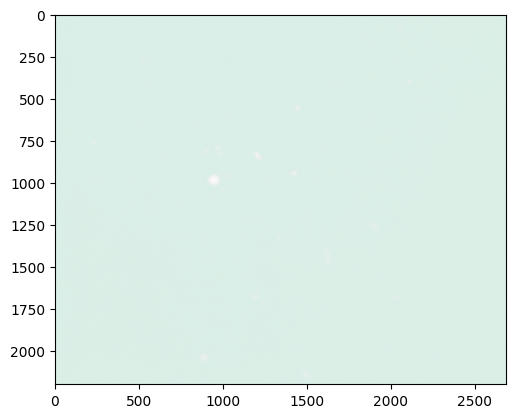

In [15]:
hist(img[:,:,0].ravel())

In [16]:
core.snap_image()  # type: ignore
tagged_image = core.get_tagged_image()  # type: ignore
tags = tagged_image.tags

In [31]:
from collections import OrderedDict  # Used by smartpath class for image tags
tagsx = OrderedDict(sorted(tags.items()))

In [ ]:
pixels = tagged_image.pix


(23654400,)

In [ ]:

total_pixels= pixels.shape[0]
height,width = tags["Height"], tags["Width"]
assert((total_pixels % (height * width)) == 0) 
nchannels = total_pixels // (height * width)
nchannels

4

In [65]:
px = pixels.reshape(height,width,nchannels)
px.shape

(2200, 2688, 4)

In [66]:
tags['Core-Camera']

'MicroPublisher6'

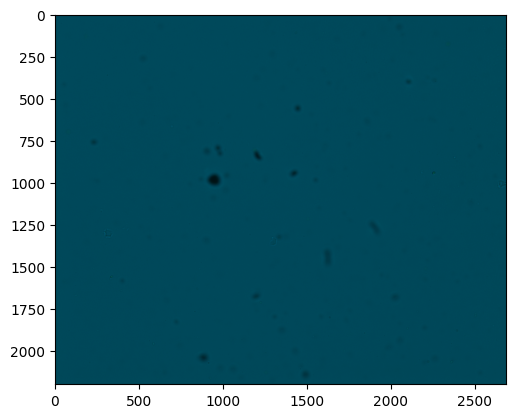

In [16]:
#microscope_hardware.snap()

In [ ]:
#from smart_wsi_scanner.smartpath import init_pycromanager
core, studio = init_pycromanager()
if not core:
    print("Failed to initialize Micro-Manager connection")

In [2]:
from smart_wsi_scanner.config import ConfigManager
config_manager = ConfigManager()
ppm_settings = config_manager.get_config('config_PPM')
ppm_settings

DataClass(microscope=Microscope(name='PPM'), stage=Stage(z_stage='ZStage', xlimit=Xlimit(low=-21000.0, high=33000.0), ylimit=Ylimit(low=-8000.0, high=11000.0), zlimit=Zlimit(low=-100, high=100), vendor='Prior'), imagingMode=Imagingmode(BF_10x=Bf_10x(isLSM=False, objectiveLens='LOCI-10x-001', pixelSize_um=0.4537, pixelOffset=Pixeloffset(x=0, y=0), stageoffset=Stageoffset(z=0, f=0), objectivePositionLabel=None, lampIntensity_V=None, detector='LOCI-CAMERA-002'), BF_20x=Bf_20x(isLSM=False, objectiveLens='LOCI-20x-002', pixelSize_um=0.2271, pixelOffset=Pixeloffset(x=0, y=0), stageoffset=Stageoffset(z=0, f=0), objectivePositionLabel=None, lampIntensity_V=None, detector='LOCI-CAMERA-002'), BF_40x=Bf_40x(isLSM=False, pixelSize_um=0.1142, pixelOffset=Pixeloffset(x=0, y=0), stageoffset=Stageoffset(z=0, f=0), objectivePositionLabel=None, lampIntensity_V=None, detector='LOCI-CAMERA-002', objectiveLens='LOCI-40x-001')), slideSize=Slidesize(x=40000, y=20000))

In [3]:
from smart_wsi_scanner.hardware import PycromanagerHardware
hardware = PycromanagerHardware(core, ppm_settings, studio)
hardware.get_current_position()

sp_position(x=7960.0, y=4820.0, z=-71.0)

In [4]:
from smart_wsi_scanner.config import sp_position
hardware.move_to_position(sp_position(x=7960,y=4821,z=-71))
hardware.get_current_position()

sp_position(x=7960.0, y=4821.0, z=-71.0)

In [5]:
sp_position(z=-72)

sp_position(z=-72.0, x=None, y=None)

In [6]:
hardware.move_to_position(sp_position(z=-72))
hardware.get_current_position()

sp_position(x=7960.0, y=4821.0, z=-72.0)

In [11]:
config_manager.list_configs()

['config_CAMM', 'config_PPM']

In [1]:
from smart_wsi_scanner.config import sp_position

In [4]:
s = sp_position(300,400,2)
s

sp_position(x=300.0, y=400.0, z=2.0)

In [6]:
s.x,s.y

(300, 400)

In [1]:
from smart_wsi_scanner.smartpath import init_pycromanager
from smart_wsi_scanner.config import ConfigManager, sp_position
from smart_wsi_scanner.hardware import PycromanagerHardware

In [ ]:
MicroscopeHardware

In [2]:
from pathlib import Path
import matplotlib.pyplot as plt

In [4]:
# Initialize Micro-Manager connection : Pycromanager for now Apr 2025
core, studio = init_pycromanager()
if not core:
    print("Failed to initialize Micro-Manager connection")


In [ ]:
# Initialize configuration
config_manager = ConfigManager()
ppm_settings = config_manager.get_config('config_PPM')

#

In [34]:
ppm_settings.stage.xlimit.high

33000.0

In [35]:
hardware = PycromanagerHardware(core, ppm_settings, studio)
hardware.core.get_property("Core", "Camera") 

'MicroPublisher6'

In [9]:
image, metadata = hardware.snap_image()

'MicroPublisher6'

In [10]:
print(f"Image shape: {image.shape}")
print(f"Image dtype: {image.dtype}")
#print("Metadata keys:", list(metadata.keys()))

Image shape: (2200, 2688, 3)
Image dtype: uint8


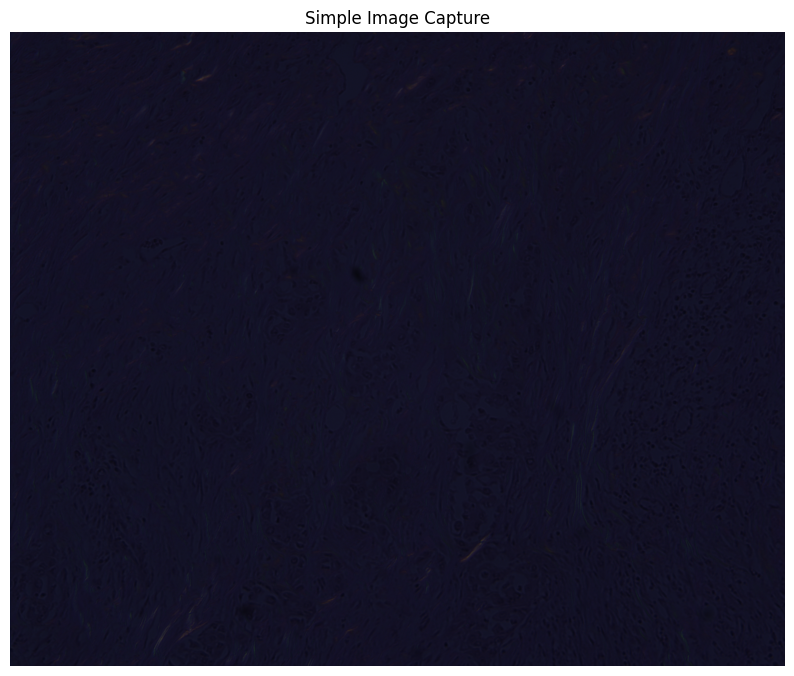

In [37]:
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.title("Simple Image Capture")
plt.axis('off')
plt.show()

In [38]:
current = hardware.get_current_position()
current

sp_position(x=7953.0, y=4823.0, z=-71.1)

In [39]:
destination = current
destination.x = current.x+10
destination

sp_position(x=7963.0, y=4823.0, z=-71.1)

In [40]:
ppm_settings.stage

Stage(z_stage='ZStage', xlimit=Xlimit(low=-21000.0, high=33000.0), ylimit=Ylimit(low=-8000.0, high=11000.0), zlimit=Zlimit(low=-100, high=100), vendor='Prior')

In [41]:
hardware.move_to_position(destination)

In [42]:
hardware.get_current_position()

sp_position(x=7963.0, y=4823.0, z=-71.1)

In [7]:
brushless = "KBD101_Thor_Rotation"
core.get_position(brushless)

270.783

## tests

In [1]:
import smart_wsi_scanner as sws

In [2]:
from smart_wsi_scanner.smartpath import init_pycromanager
core, studio = init_pycromanager()

In [3]:
from smart_wsi_scanner.smartpath import init_pycromanager
core, studio = init_pycromanager()
if core.get_property("MicroPublisher6","Color")=="OFF":
    core.set_property("MicroPublisher6","Color","ON")
if core.get_property("MicroPublisher6","Color - Algorithm CFA") != "G-R-B-G":
    core.set_property("MicroPublisher6","Color - Algorithm CFA", "G-R-B-G")


In [5]:
brushless = "KBD101_Thor_Rotation"
core.get_position(brushless)

296

In [7]:

angle = -10
def ppm_to_thor(angle):
    return (-2*angle + 276)

newAngle = ppm_to_thor(angle)
core.set_position(brushless, newAngle)
core.get_position(brushless)

New angle calculated 296...


296

In [10]:
import smart_wsi_scanner.smartpath as sp
x,y = sp.snap(core)

Capture Failed: SP doesn't recognize : tags['Core-Camera']='MicroPublisher6'


## read Mike's color correction configs

In [27]:
import csv
from dataclasses import dataclass
from typing import List

@dataclass
class ColorPreset:
    name: str
    color: str
    color_algorithm_cfa: str
    color_blue_scale: float
    color_green_scale: float
    color_red_scale: float
    exposure: float
    objective_label: str
    
    def apply_to_camera(self, core, device="MicroPublisher6", objective_device="DObjective"):
            # Apply color and algorithm
            core.set_property(device, "Color", self.color)
            core.set_property(device, "Color - Algorithm CFA", self.color_algorithm_cfa)
            core.set_property(device, "Color - Blue scale", self.color_blue_scale)
            core.set_property(device, "Color - Green scale", self.color_green_scale)
            core.set_property(device, "Color - Red scale", self.color_red_scale)
            core.set_property(device, "Exposure", self.exposure)
            core.set_property(objective_device, "Label", self.objective_label)

def parse_all_presets(cfg_path: str) -> List[ColorPreset]:
    presets = []
    current_name = None
    current_values = {}
    with open(cfg_path, newline='') as csvfile:
        for line in csvfile:
            line = line.strip()
            if not line:
                continue
            # Detect preset header
            if line.startswith("#") or (line.startswith("[") and line.endswith("]")):
                # Save previous preset if exists
                if current_name and current_values:
                    try:
                        presets.append(ColorPreset(name=current_name, **current_values))
                    except Exception as e:
                        print(f"Skipping preset {current_name} due to error: {e}")
                # Start new preset
                current_name = line.strip("#[] ").strip()
                current_values = {}
                continue
            # Parse CSV line
            row = next(csv.reader([line]))
            if len(row) < 6:
                continue
            prop = row[4].lower().replace(" ", "_").replace("-", "_")
            value = row[5]
            # Map config property to dataclass field
            if prop == "color":
                current_values["color"] = value
            elif prop == "color___algorithm_cfa":
                current_values["color_algorithm_cfa"] = value
            elif prop == "color___blue_scale":
                current_values["color_blue_scale"] = float(value)
            elif prop == "color___green_scale":
                current_values["color_green_scale"] = float(value)
            elif prop == "color___red_scale":
                current_values["color_red_scale"] = float(value)
            elif prop == "exposure":
                current_values["exposure"] = float(value)
            elif prop == "label":
                current_values["objective_label"] = value
        # Save last preset
        if current_name and current_values:
            try:
                presets.append(ColorPreset(name=current_name, **current_values))
            except Exception as e:
                print(f"Skipping preset {current_name} due to error: {e}")
    return presets


In [28]:
# Usage
presets = parse_all_presets("../smart_wsi_scanner/configurations/config_PPM.cfg")
#for preset in presets:
#    print(preset)
presets

Skipping preset Preset: Startup due to error: ColorPreset.__init__() missing 5 required positional arguments: 'color_algorithm_cfa', 'color_blue_scale', 'color_green_scale', 'color_red_scale', and 'exposure'
Skipping preset Preset: 10x 0.3 due to error: ColorPreset.__init__() missing 6 required positional arguments: 'color', 'color_algorithm_cfa', 'color_blue_scale', 'color_green_scale', 'color_red_scale', and 'exposure'
Skipping preset Preset: 40x 0.5 red Pol due to error: ColorPreset.__init__() missing 6 required positional arguments: 'color', 'color_algorithm_cfa', 'color_blue_scale', 'color_green_scale', 'color_red_scale', and 'exposure'
Skipping preset Preset: 20x 0.5 due to error: ColorPreset.__init__() missing 6 required positional arguments: 'color', 'color_algorithm_cfa', 'color_blue_scale', 'color_green_scale', 'color_red_scale', and 'exposure'
Skipping preset Preset: 40x 0.75 due to error: ColorPreset.__init__() missing 6 required positional arguments: 'color', 'color_algori

[ColorPreset(name='Preset: ColorOn 10x 5deg', color='ON', color_algorithm_cfa='G-B-R-G', color_blue_scale=2.4344, color_green_scale=1.0, color_red_scale=1.1621, exposure=200.0, objective_label='10x 0.3'),
 ColorPreset(name='Preset: ColorOn 20x 0deg', color='ON', color_algorithm_cfa='G-B-R-G', color_blue_scale=2.2428, color_green_scale=1.014, color_red_scale=1.0, exposure=200.0, objective_label='20x 0.5'),
 ColorPreset(name='Preset: ColorOn 10x 0deg', color='ON', color_algorithm_cfa='G-R-B-G', color_blue_scale=1.0, color_green_scale=1.1691, color_red_scale=1.8056, exposure=500.0, objective_label='10x 0.3'),
 ColorPreset(name='Preset: ColorOn 40x 5deg', color='ON', color_algorithm_cfa='G-B-R-G', color_blue_scale=2.8488, color_green_scale=1.2352, color_red_scale=1.0, exposure=500.0, objective_label='40x 0.75'),
 ColorPreset(name='Preset: ColorOn 10x 50deg', color='ON', color_algorithm_cfa='G-B-R-G', color_blue_scale=3.7246, color_green_scale=1.0, color_red_scale=1.0712, exposure=4.0, obje

In [29]:
for kx,k in enumerate(presets):
    print(kx, k.name)

0 Preset: ColorOn 10x 5deg
1 Preset: ColorOn 20x 0deg
2 Preset: ColorOn 10x 0deg
3 Preset: ColorOn 40x 5deg
4 Preset: ColorOn 10x 50deg
5 Preset: ColorOn 40x 50deg
6 Preset: ColorOn 40x 0deg
7 Preset: ColorOn 20x 50deg
8 Preset: Raw
9 Preset: ColorOn 20x 5deg


In [31]:
presets[1].apply_to_camera(core)

In [ ]:
""

In [4]:
core.get_position()

-55.1

In [3]:
core.get_position("KBD101_Thor_Rotation")
stage_name = "KBD101_28253598"

Exception: java.lang.Exception: No device with label "KBD101_Thor_Rotation"
mmcorej.MMCoreJJNI.CMMCore_getPosition__SWIG_0(Native Method)
mmcorej.CMMCore.getPosition(CMMCore.java:1236)
sun.reflect.NativeMethodAccessorImpl.invoke0(Native Method)
sun.reflect.NativeMethodAccessorImpl.invoke(NativeMethodAccessorImpl.java:62)
sun.reflect.DelegatingMethodAccessorImpl.invoke(DelegatingMethodAccessorImpl.java:43)
java.lang.reflect.Method.invoke(Method.java:498)
org.micromanager.pyjavaz.ZMQServer.runMethod(ZMQServer.java:431)
org.micromanager.pyjavaz.ZMQServer.parseAndExecuteCommand(ZMQServer.java:511)
org.micromanager.pyjavaz.ZMQServer.lambda$initialize$2(ZMQServer.java:121)
java.util.concurrent.Executors$RunnableAdapter.call(Executors.java:511)
java.util.concurrent.FutureTask.run(FutureTask.java:266)
java.util.concurrent.ThreadPoolExecutor.runWorker(ThreadPoolExecutor.java:1149)
java.util.concurrent.ThreadPoolExecutor$Worker.run(ThreadPoolExecutor.java:624)
java.lang.Thread.run(Thread.java:748)


In [ ]:
brushless = "KBD101_Thor_Rotation";
print("Homing " + brushless + "...");
mmc.home(brushless);
mmc.waitForDevice(brushless);
// One more time, in case it failed the first time.
mmc.home(brushless);
mmc.waitForDevice(brushless);
print("Motor homed at: " + mmc.getPosition(brushless));

In [12]:
import platform
import psutil

if platform.system() != "Windows":
    print(platform)

for proc in psutil.process_iter(['name']):
    try:
        if "ImageJ.exe" in proc.info['name'] or "Micro-Manager" in proc.info['name']:
            print("runing")
    except (psutil.NoSuchProcess, psutil.AccessDenied, psutil.ZombieProcess):
        pass


not running


In [21]:
for proc in psutil.process_iter(['name']):
    name = proc.info['name']
    if name.startswith('j'):print(name); break
    

javaw.exe


True